# 2D pose


In [ ]:
import sys
import tensorflow.keras
import pandas as pd
import sklearn as sk
import tensorflow as tf
%matplotlib inline

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# change dir
%cd drive/MyDrive/openpose

/content/drive/MyDrive/openpose


In [ ]:
# !python pose_detector.py posenet models/coco_posenet.npz --img data/images2.jpg
!python pose_detector.py posenet models/coco_posenet.npz --img data/images2.jpg --gpu 0

Loading the model...
pose_detector.py:147: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  paf_in_edge = np.hstack([paf[0][np.hsplit(integ_points, 2)], paf[1][np.hsplit(integ_points, 2)]])
Saving result into result.png...


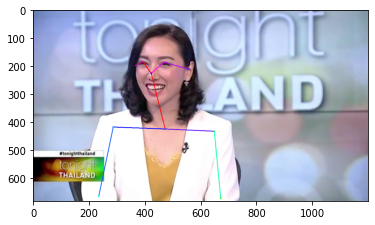

In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

img = cv2.imread('/content/drive/MyDrive/openpose/result.png')
img_cvt=cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img_cvt)
plt.show()

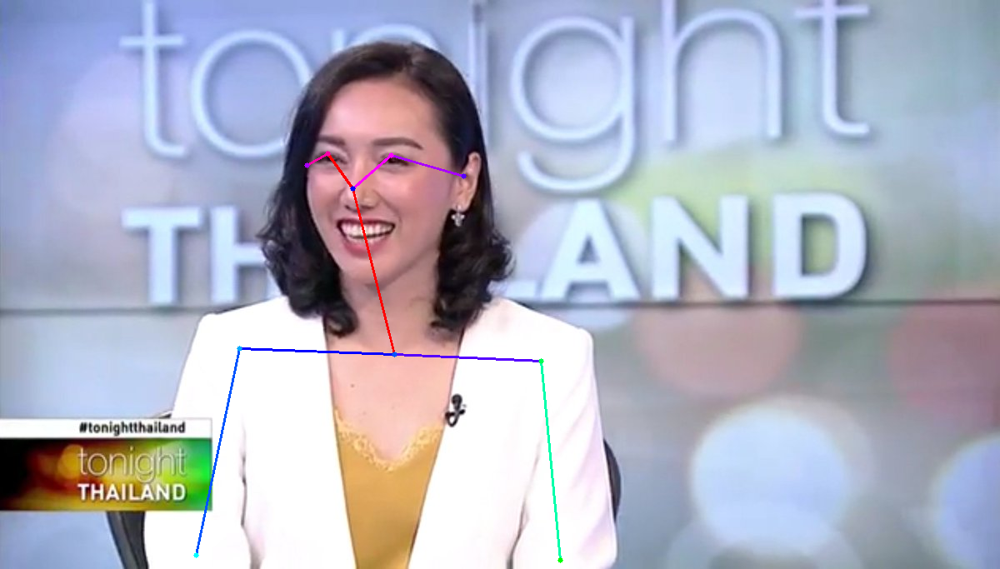

In [ ]:
from google.colab.patches import cv2_imshow
import cv2
img = cv2.imread('/content/drive/MyDrive/openpose/result.png')
cv2_imshow(img)

# Face 

In [ ]:
# !python face_detector.py facenet models/facenet.npz --img data/MMyVfrYT.jpg
!python face_detector.py facenet models/facenet.npz --img data/MMyVfrYT.jpg --gpu 0

Loading FaceNet...
Saving result into resultface.png...


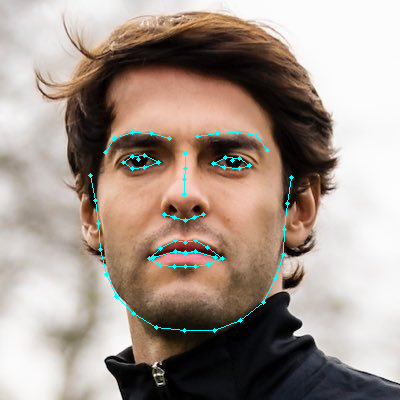

In [ ]:
from google.colab.patches import cv2_imshow
import cv2
img = cv2.imread('/content/drive/MyDrive/openpose/result_face.png')
cv2_imshow(img)

# Hand

In [ ]:
# !python hand_detector.py handnet models/handnet.npz --img data/hand.png
!python hand_detector.py handnet models/handnet.npz --img data/hand.png --gpu 0

Loading HandNet...
Saving result into result_hand.png...


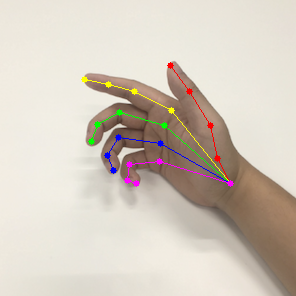

In [ ]:
from google.colab.patches import cv2_imshow
import cv2
img = cv2.imread('/content/drive/MyDrive/openpose/result_hand.png')
cv2_imshow(img)

# 2Dpose + face + Hand

In [ ]:
# !python demo.py --img data/dinner.png
!python demo.py --img data/dinner.png --gpu 0

Loading the model...
Loading HandNet...
Loading FaceNet...
Estimating pose...
/content/drive/My Drive/openpose/pose_detector.py:147: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  paf_in_edge = np.hstack([paf[0][np.hsplit(integ_points, 2)], paf[1][np.hsplit(integ_points, 2)]])
Estimating face keypoints...
Estimating hands keypoints...
Saving result into result_demo.png...


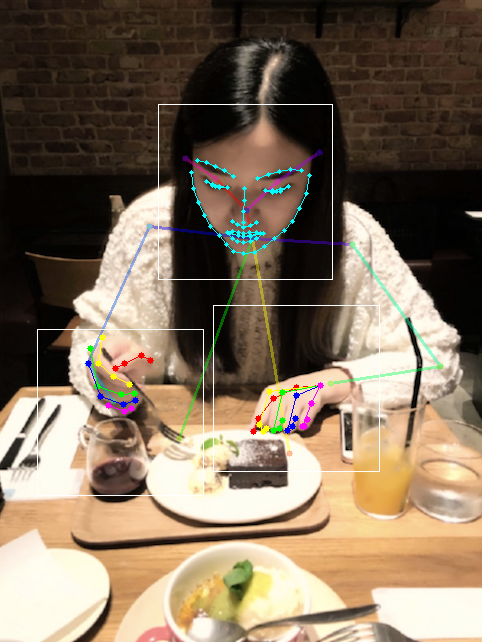

In [ ]:
from google.colab.patches import cv2_imshow
import cv2
img = cv2.imread('/content/drive/MyDrive/openpose/result_demo.png')
cv2_imshow(img)

# Cam

In [ ]:
# !python camera_pose_demo.py

# Process one by one [Body]

Loading the model...


/content/drive/My Drive/openpose/pose_detector.py:147: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  paf_in_edge = np.hstack([paf[0][np.hsplit(integ_points, 2)], paf[1][np.hsplit(integ_points, 2)]])


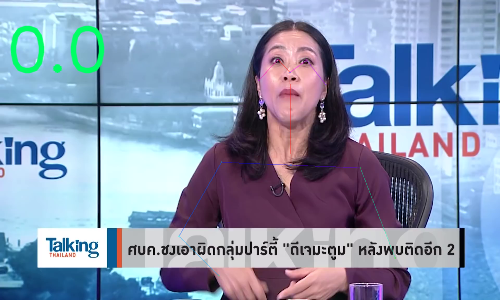

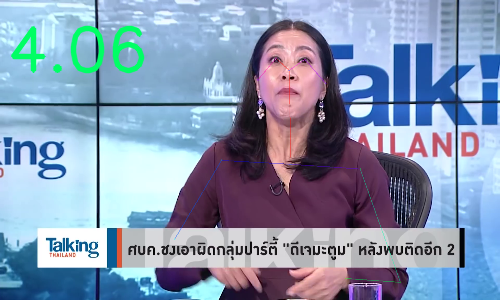

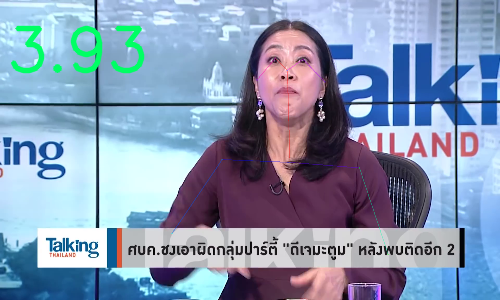

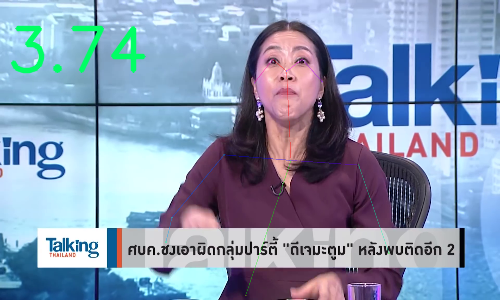

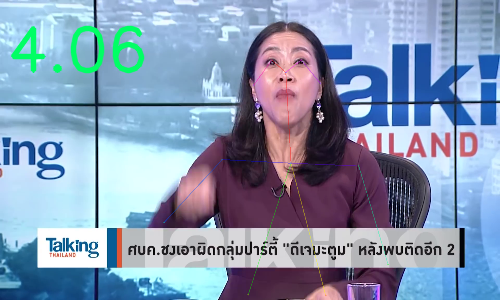

...

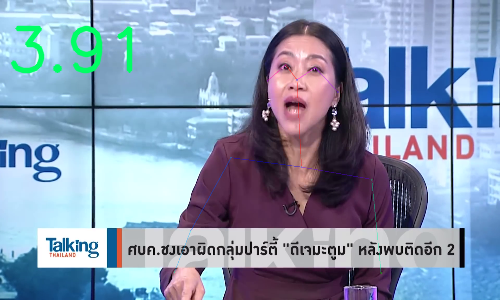

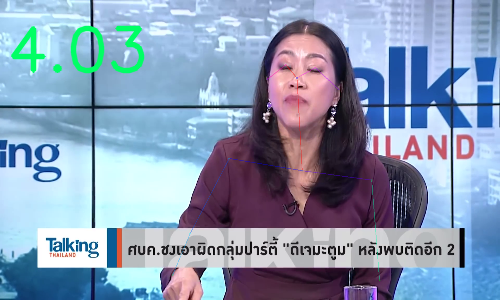

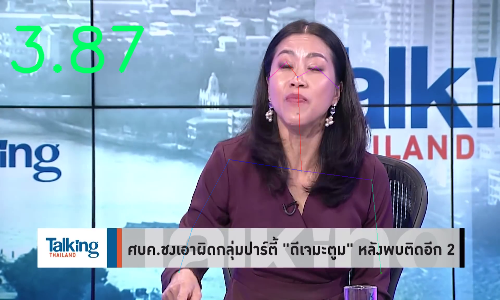

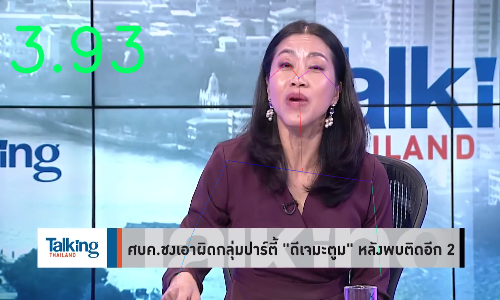

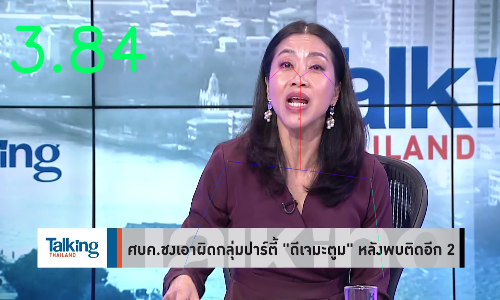

In [ ]:
import cv2
# import argparse
import chainer
import time 
from pose_detector import PoseDetector, draw_person_pose
from google.colab.patches import cv2_imshow
chainer.using_config('enable_backprop', False)

# load model
# pose_detector = PoseDetector("posenet", "models/coco_posenet.npz")
pose_detector = PoseDetector("posenet", "models/coco_posenet.npz", device=0) #GPU
cap = cv2.VideoCapture('/content/drive/MyDrive/openpose/TalkingThailand.mp4')

prev_frame_time = 0
new_frame_time = 0

cap.set(cv2.CAP_PROP_FRAME_WIDTH, 640)
cap.set(cv2.CAP_PROP_FRAME_HEIGHT, 480)

while True:
    ret, img = cap.read()

    if not ret:
        print("Failed to capture image")
        break

    person_pose_array, _ = pose_detector(img)
    res_img = cv2.addWeighted(img, 0.6, draw_person_pose(img, person_pose_array), 0.4, 0)
    
    font = cv2.FONT_HERSHEY_SIMPLEX 
    new_frame_time = time.time() 
    fps = 1/(new_frame_time-prev_frame_time) 
    prev_frame_time = new_frame_time 
    fps = round(fps,2) 
    fps = str(fps) 
    res_img = cv2.resize(res_img, (500, 300))
    cv2.putText(res_img, fps, (7, 70), font, 2, (100, 255, 0), 3, cv2.LINE_AA) 
    
    cv2_imshow(res_img)
    cv2.waitKey(1)

# Process one by one [Face]

Loading FaceNet...


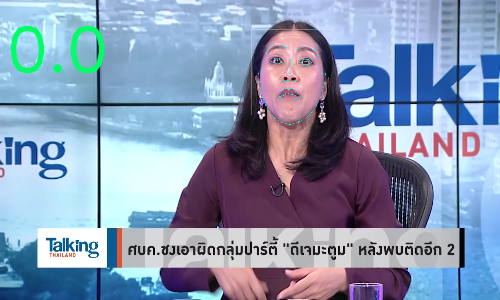

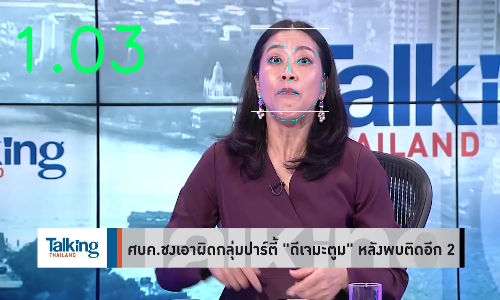

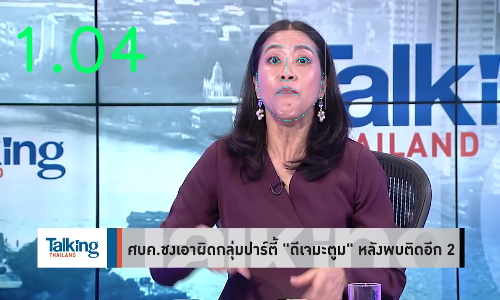

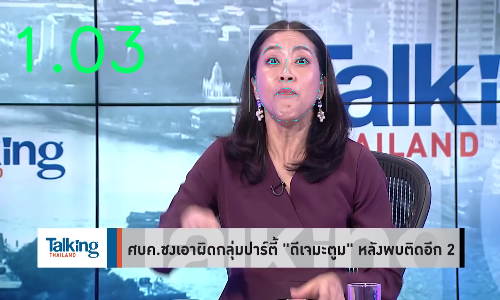

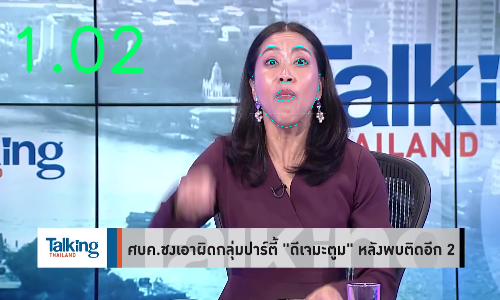

...

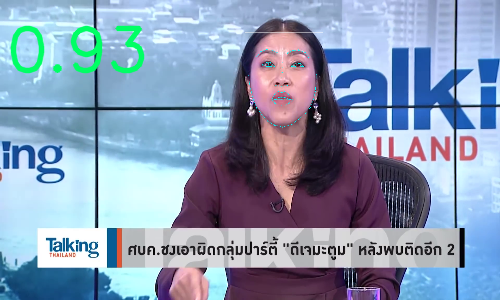

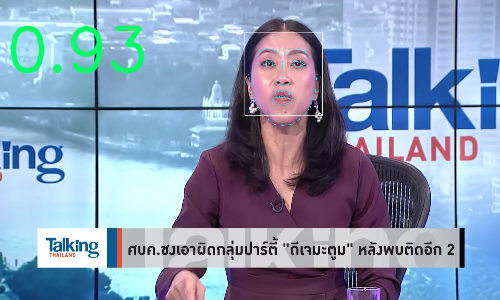

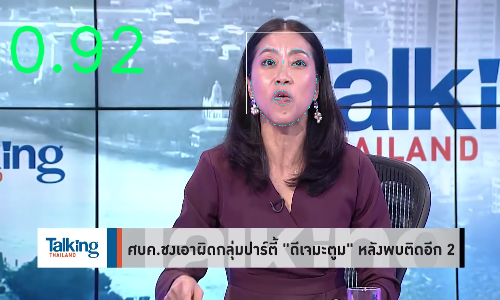

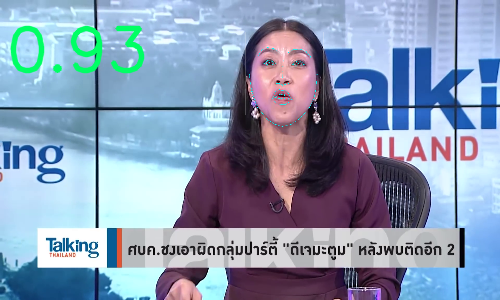

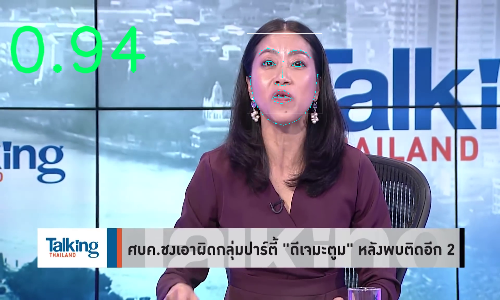

KeyboardInterrupt: ignored

In [ ]:
import cv2
import argparse
import chainer
import numpy as np
from entity import params
import time 
from google.colab.patches import cv2_imshow
from face_detector import FaceDetector, draw_face_keypoints
chainer.using_config('enable_backprop', False)

def crop_face(img, rect):
    orig_img_h, orig_img_w, _ = img.shape
    crop_center_x = rect[0] + rect[2] / 2
    crop_center_y = rect[1] + rect[3] / 2
    crop_width = rect[2] * params['face_crop_scale']
    crop_height = rect[3] * params['face_crop_scale']
    crop_left = max(0, int(crop_center_x - crop_width / 2))
    crop_top = max(0, int(crop_center_y - crop_height / 2))
    crop_right = min(orig_img_w, int(crop_center_x + crop_width / 2))
    crop_bottom = min(orig_img_h, int(crop_center_y + crop_height / 2))
    cropped_face = img[crop_top:crop_bottom, crop_left:crop_right]
    max_edge_len = np.max(cropped_face.shape[:-1])
    padded_face = np.zeros((max_edge_len, max_edge_len, cropped_face.shape[-1]), dtype=np.uint8)
    padded_face[0:cropped_face.shape[0], 0:cropped_face.shape[1]] = cropped_face
    return padded_face, (crop_left, crop_top)

# load model
face_detector = FaceDetector("facenet", "models/facenet.npz", device=0) # GPU
cascade = cv2.CascadeClassifier("models/haarcascade_frontalface_alt.xml")

cap = cv2.VideoCapture('/content/drive/MyDrive/openpose/TalkingThailand.mp4')
cap.set(cv2.CAP_PROP_FRAME_WIDTH, 640)
cap.set(cv2.CAP_PROP_FRAME_HEIGHT, 480)

prev_frame_time = 0
new_frame_time = 0

while True:
    ret, img = cap.read()

    if not ret:
        print("Failed to capture image")
        break

    # crop face
    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    facerects = cascade.detectMultiScale(gray_img, scaleFactor=1.2, minNeighbors=3, minSize=(1, 1))
    res_img = img.copy()
    if len(facerects) > 0:
        for facerect in facerects:
            cv2.rectangle(res_img, (facerect[0], facerect[1]), (facerect[0] + facerect[2], facerect[1] + facerect[3]), (255, 255, 255), 1)
            cropped_face, face_left_top = crop_face(img, facerect)
            face_keypoints = face_detector(cropped_face)
            res_img = draw_face_keypoints(res_img, face_keypoints, face_left_top)

    font = cv2.FONT_HERSHEY_SIMPLEX 
    new_frame_time = time.time() 
    fps = 1/(new_frame_time-prev_frame_time) 
    prev_frame_time = new_frame_time 
    fps = round(fps,2) 
    fps = str(fps) 

    res_img = cv2.resize(res_img, (500, 300))
    cv2.putText(res_img, fps, (7, 70), font, 2, (100, 255, 0), 3, cv2.LINE_AA)

    cv2_imshow(res_img)
    cv2.waitKey(1)